In [ ]:
from google.colab import drive

drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!unzip /content/drive/MyDrive/dataset.zip -d /content

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005001.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005002.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005003.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005004.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005005.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005006.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005007.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005008.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005009.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005010.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005011.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005012.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005013.jpg  
  inflating: /content/dataset/StyleGAN2/SFHQ_pt4_00005014.jpg  
  inflating: /content/dataset/StyleG

In [ ]:
import os
import pandas as pd
from PIL import Image

In [ ]:
data = {'img':[], 'label':[], }
path = '/content/dataset'
folder = os.listdir(path)
class_name = {'real':0, 'StyleGAN':1, 'StyleGAN2':2}

for target in folder:
  images = os.listdir(path +'/'+target)
  cnt = 0
  for image in images:
    data['img'].append(Image.open(path +'/'+target + '/' +image))
    data['label'].append(class_name[target])
    cnt += 1
    if cnt == 2000:
      break

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(data['img'], data['label'], test_size=0.20, random_state=42, shuffle=True)

NameError: name 'data' is not defined

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.10, random_state=42, shuffle=True)

In [ ]:
import torch
import torchvision
from torchvision import transforms
from torchsummary import summary
from torch.utils.data import DataLoader,Dataset
import numpy as np
import matplotlib.pyplot as plt

class MyDataset(Dataset):
    def __init__(self, data, targets,transform=None):
        self.data = data
        self.targets = torch.LongTensor(targets)
        self.transform = transform

    def __getitem__(self, index):
        x = self.data[index]
        y = self.targets[index]
        if self.transform:
            x = self.transform(x)

        return x, y

    def __len__(self):
        return len(self.data)

In [ ]:
from transformers import ViTImageProcessor

processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
image_mean = processor.image_mean
image_std = processor.image_std
size = processor.size["height"]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

In [ ]:
from torchvision.transforms import (CenterCrop,
                                    Compose,
                                    Normalize,
                                    RandomHorizontalFlip,
                                    RandomResizedCrop,
                                    Resize,
                                    ToTensor)

normalize = Normalize(mean=image_mean, std=image_std)
_train_transforms = Compose(
        [
            RandomResizedCrop(size),
            RandomHorizontalFlip(),
            ToTensor(),
            normalize,
        ]
    )

_val_transforms = Compose(
        [
            Resize(size),
            CenterCrop(size),
            ToTensor(),
            normalize,
        ]
    )

In [ ]:
train_set = MyDataset(X_train,y_train, transform=_train_transforms)
trainloader = DataLoader(train_set, batch_size=16, shuffle=True)

test_set = MyDataset(X_test,y_test, transform=_val_transforms)
testloader = DataLoader(test_set, batch_size=1)

val_set =  MyDataset(X_val,y_val, transform=_val_transforms)
valloader = DataLoader(val_set, batch_size=16)

In [ ]:
%pip install pytorch-lightning

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 802.2/802.2 kB 10.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 868.8/868.8 kB 18.5 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-man

In [ ]:
id2label = {0:'real', 1:'StyleGAN', 2:'StyleGAN2'}

In [ ]:
import pytorch_lightning as pl
from transformers import ViTForImageClassification
import torch.nn as nn
from torch.optim import AdamW

class ViT(pl.LightningModule):
    def __init__(self, num_labels=3):
        super(ViT, self).__init__()
        self.vit = ViTForImageClassification.from_pretrained('google/vit-base-patch16-224-in21k',
                                                              num_labels=3,
                                                              id2label=id2label,
                                                              label2id=class_name)

    def forward(self, pixel_values):
        outputs = self.vit(pixel_values=pixel_values)
        return outputs.logits

    def common_step(self, batch, batch_idx):
        pixel_values = batch[0]
        labels = batch[1]
        logits = self(pixel_values)

        criterion = nn.CrossEntropyLoss()
        loss = criterion(logits, labels)
        predictions = logits.argmax(-1)
        correct = (predictions == labels).sum().item()
        accuracy = correct/pixel_values.shape[0]

        return loss, accuracy

    def training_step(self, batch, batch_idx):
        loss, accuracy = self.common_step(batch, batch_idx)
        # logs metrics for each training_step,
        # and the average across the epoch
        self.log("training_loss", loss)
        self.log("training_accuracy", accuracy)

        return loss

    def validation_step(self, batch, batch_idx):
        loss, accuracy = self.common_step(batch, batch_idx)
        self.log("validation_loss", loss, on_epoch=True)
        self.log("validation_accuracy", accuracy, on_epoch=True)

        return loss

    def test_step(self, batch, batch_idx):
        loss, accuracy = self.common_step(batch, batch_idx)
        self.log("test_accuracy", accuracy)

        return loss

    def configure_optimizers(self):
        # We could make the optimizer more fancy by adding a scheduler and specifying which parameters do
        # not require weight_decay but just using AdamW out-of-the-box works fine
        return AdamW(self.parameters(), lr=2e-5)

    def train_dataloader(self):
        return trainloader

    def val_dataloader(self):
        return valloader

    def test_dataloader(self):
        return testloader

In [ ]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

In [ ]:
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks import EarlyStopping

# for early stopping, see https://pytorch-lightning.readthedocs.io/en/1.0.0/early_stopping.html?highlight=early%20stopping
early_stop_callback = EarlyStopping(
    monitor='val_loss',
    patience=3,
    strict=False,
    verbose=False,
    mode='min'
)

model = ViT()
trainer = Trainer(callbacks=[EarlyStopping(monitor='validation_loss')], max_epochs=10)
trainer.fit(model=model)

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name | Type                      | Params
---------------------------------------------------
0 | vit  | ViTForImageClassification | 85.8 M
---------------------------------------------------
85.8 M    Trainable params
0         Non-tra

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.


In [ ]:
trainer.test(dataloaders=testloader,ckpt_path='best')

INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at /content/lightning_logs/version_0/checkpoints/epoch=9-step=2700.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from the checkpoint at /content/lightning_logs/version_0/checkpoints/epoch=9-step=2700.ckpt


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│       test_accuracy       │    0.9858333468437195     │
└───────────────────────────┴───────────────────────────┘

[{'test_accuracy': 0.9858333468437195}]

In [ ]:
!zip -r light_logs.zip lightning_logs/

	zip warning: name not matched: lightning_logs/

zip error: Nothing to do! (try: zip -r light_logs.zip . -i lightning_logs/)


In [ ]:
from google.colab import files
files.download("light_logs.zip")

FileNotFoundError: Cannot find file: light_logs.zip

In [ ]:
!unzip /content/drive/MyDrive/light_logs.zip -d /content

Archive:  /content/drive/MyDrive/light_logs.zip
   creating: /content/lightning_logs/
   creating: /content/lightning_logs/version_0/
   creating: /content/lightning_logs/version_0/checkpoints/
  inflating: /content/lightning_logs/version_0/checkpoints/epoch=9-step=2700.ckpt  
  inflating: /content/lightning_logs/version_0/events.out.tfevents.1714034819.7fe117494579.387.1  
  inflating: /content/lightning_logs/version_0/events.out.tfevents.1714032214.7fe117494579.387.0  
 extracting: /content/lightning_logs/version_0/hparams.yaml  


In [ ]:
class_name = {'real':0, 'StyleGAN':1, 'StyleGAN2':2}

In [ ]:
ViT()

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


ViT(
  (vit): ViTForImageClassification(
    (vit): ViTModel(
      (embeddings): ViTEmbeddings(
        (patch_embeddings): ViTPatchEmbeddings(
          (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
        )
        (dropout): Dropout(p=0.0, inplace=False)
      )
      (encoder): ViTEncoder(
        (layer): ModuleList(
          (0-11): 12 x ViTLayer(
            (attention): ViTAttention(
              (attention): ViTSelfAttention(
                (query): Linear(in_features=768, out_features=768, bias=True)
                (key): Linear(in_features=768, out_features=768, bias=True)
                (value): Linear(in_features=768, out_features=768, bias=True)
                (dropout): Dropout(p=0.0, inplace=False)
              )
              (output): ViTSelfOutput(
                (dense): Linear(in_features=768, out_features=768, bias=True)
                (dropout): Dropout(p=0.0, inplace=False)
              )
            )
            (intermediate)

In [ ]:
model = ViT.load_from_checkpoint("/content/lightning_logs/version_0/checkpoints/epoch=9-step=2700.ckpt")

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
criterion = nn.CrossEntropyLoss()

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score

def test_model(model, dataloader, criterion, show_images=False, num_images=10):
    name_lookup = {v: k for k, v in class_name.items()}

    model.eval()  # Set the model to evaluation mode
    total_loss = 0.0
    total_samples = 0
    all_preds = []
    all_labels = []
    incorrect_samples = []
    incorrect_count = 0


    # No need to track gradients for testing
    with torch.no_grad():
        for inputs, labels in dataloader:

            inputs = inputs.to('cuda')
            labels = labels.to('cuda')

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)
            total_loss += loss.item() * inputs.size(0)
            total_samples += inputs.size(0)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

            # Collect incorrect samples
            misclassified_indices = (preds != labels).nonzero().flatten()
            incorrect_count += len(misclassified_indices)
            for index in misclassified_indices:
                incorrect_samples.append((inputs[index], labels[index].item(), preds[index].item()))

    # Calculate metrics
    precision = precision_score(all_labels, all_preds, average='macro')
    recall = recall_score(all_labels, all_preds, average='macro')
    f1 = f1_score(all_labels, all_preds, average='macro')
    print(f'Test Loss: {total_loss / total_samples:.4f}')
    print(f'Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}')
    print(f'Incorrectly Labeled: {incorrect_count}/{total_samples} ({incorrect_count/total_samples*100:.2f}%)')

    if show_images and incorrect_samples:
        # Display first few misclassified images
        fig, axes = plt.subplots(1, min(num_images, len(incorrect_samples)), figsize=(15, 3))
        for i, (img, true, pred) in enumerate(incorrect_samples[:num_images]):
            ax = axes[i] if num_images > 1 else axes
            img = img.cpu().numpy().transpose((1, 2, 0))  # Assuming image tensor format: CxHxW
            img = np.clip(img, 0, 1)
            ax.imshow(img, interpolation='nearest')
            ax.set_title(f'True: {name_lookup[true]},\nPred: {name_lookup[pred]}')
            ax.axis('off')
        plt.show()

    return total_loss / total_samples, precision, recall, f1, all_labels, all_preds

Test Loss: 0.0386
Precision: 0.9854, Recall: 0.9852, F1 Score: 0.9852
Incorrectly Labeled: 17/1200 (1.42%)


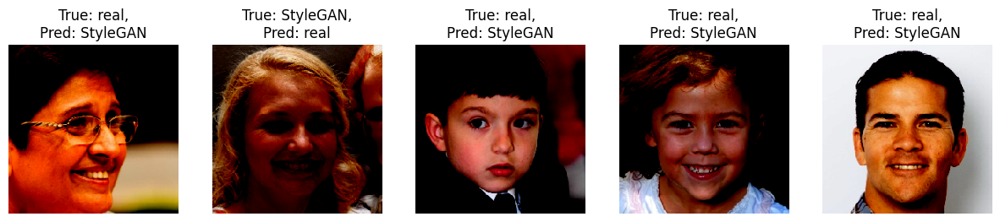

In [ ]:
test_loss, test_precision, test_recall, test_f1, all_labels, all_preds = test_model(model, testloader, criterion, show_images=True, num_images=5)

In [ ]:
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
confusion_matrix(all_labels, all_preds)

array([[371,  11,   1],
       [  4, 375,   1],
       [  0,   0, 437]])

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(all_labels, all_preds))

              precision    recall  f1-score   support

           0       0.99      0.97      0.98       383
           1       0.97      0.99      0.98       380
           2       1.00      1.00      1.00       437

    accuracy                           0.99      1200
   macro avg       0.99      0.99      0.99      1200
weighted avg       0.99      0.99      0.99      1200



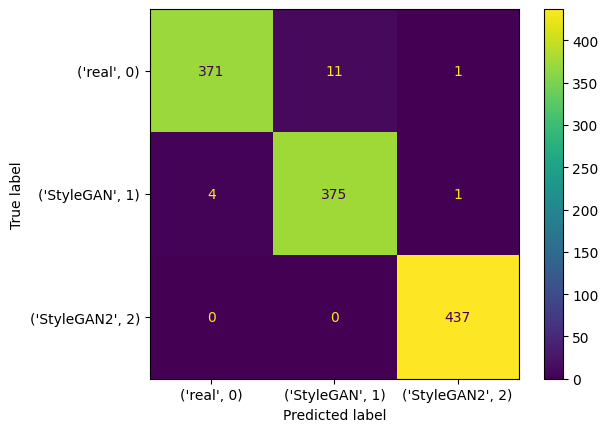

In [ ]:
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(all_labels, all_preds), display_labels=class_name.items())
disp.plot()
plt.show()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

In [ ]:
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [ ]:
def predict_image(model, image_path, true_label):
  model.eval()
  image = Image.open(image_path)
  X_test = [image]
  y_test = [true_label]
  test_set = MyDataset(X_test,y_test, transform=_val_transforms)
  testloader = DataLoader(test_set, batch_size=1)
  with torch.no_grad():
    for inputs, labels in testloader:
      inputs = inputs.to('cuda')
      labels = labels.to('cuda')
      logits = model(inputs)
      _, preds = torch.max(logits, 1)
      if preds == 2:
        preds = 1

  return preds

In [ ]:
path = "/content/drive/MyDrive/ai and human faces/"
folder = os.listdir(path)

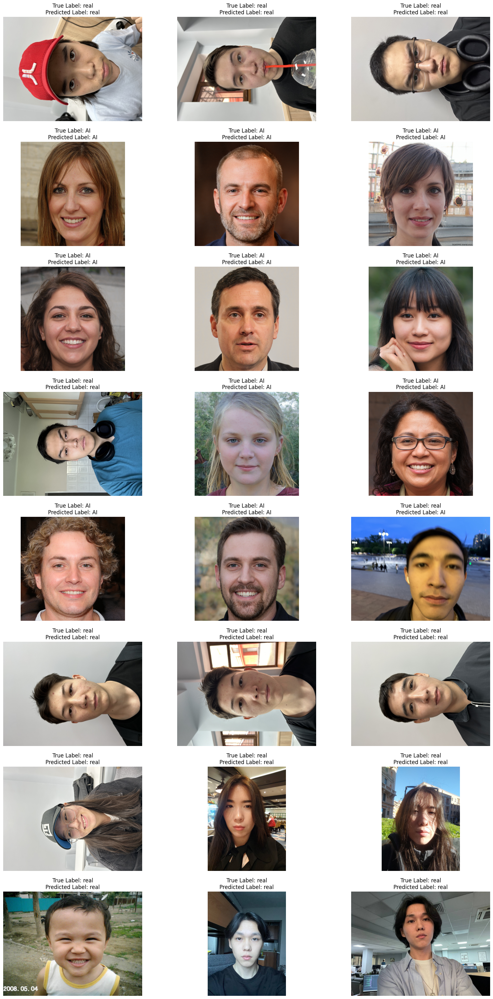

In [ ]:
num_images = len(folder)
num_cols = 3
num_rows = (num_images // num_cols) + (num_images % num_cols)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 5*num_rows))

for i, ax in enumerate(axes.flat):
    if i < num_images:
        image_path = os.path.join(path, folder[i])
        true_label = 0 if 'human' in folder[i] else 1
        prediction = predict_image(model, image_path, true_label)

        # Load and display image
        image = Image.open(image_path)
        ax.imshow(image)
        ax.axis('off')

        ax.set_title(f"True Label: {'real' if true_label == 0 else 'AI'}\nPredicted Label: {'real' if prediction == 0 else 'AI'}")

plt.show()